# DSCI 631, Applied Machine Learning
# Title : Diamond Price Prediction

## Team members: Himanshu Jat, Richard Hong, Manoj Venkatachalaiah

## ----------------------------------------------------------------------------------------------------------------------------------

## Project Overview

Our project is divided into two stages:

1) Regression : Where we have predicted the retail price of diamonds by making use of different features in the dataset

2) Classification-then-regression: Where we have classifed each instance into a cluster based on several features and then predicted the retail price of diamonds in each cluster.

## Data description

Attributes and description:


price(target attribute): price in US dollars (\\$326--\\$18,823)

carat: weight of the diamond (0.2--5.01)

cut: quality of the cut (Fair, Good, Very Good, Premium, Ideal)

color: diamond colour, from D (best) to J (worst)

clarity: a measurement of how clear the diamond is (I1 (worst), SI2, SI1, VS2, VS1, VVS2, VVS1, IF (best))

x: length in mm (0--10.74)

y: width in mm (0--58.9)

z: depth in mm (0--31.8)

depth: total depth percentage = z / mean(x, y) = 2 * z / (x + y) (43--79)

table: width of top of diamond relative to widest point (43--95)



## Algorithms used:

1) Linear Regression

2) DecisionTreeRegressor

3) RandomForestRegressor

4) KNeighborsRegressor

5) XGBRegressor

#### The above algorithms are a mixture of regression and tree based regression algorithms. They were picked because our dataset has a good split between numerical and categorical features and we believe we will get good results using said algorithms.

## Linear Regression

#### What is Linear Regression?
Linear regression is a basic and commonly used type of predictive analysis.  The overall idea of regression is to examine two things: (1) does a set of predictor variables do a good job in predicting an outcome (dependent) variable?  (2) Which variables in particular are significant predictors of the outcome variable, and in what way do they–indicated by the magnitude and sign of the beta estimates–impact the outcome variable?  These regression estimates are used to explain the relationship between one dependent variable and one or more independent variables.  The simplest form of the regression equation with one dependent and one independent variable is defined by the formula y = c + b*x, where y = estimated dependent variable score, c = constant, b = regression coefficient, and x = score on the independent variable.


First, the regression might be used to identify the strength of the effect that the independent variable(s) have on a dependent variable.  Typical questions are what is the strength of relationship between dose and effect, sales and marketing spending, or age and income.

Second, it can be used to forecast effects or impact of changes.  That is, the regression analysis helps us to understand how much the dependent variable changes with a change in one or more independent variables.  A typical question is, “how much additional sales income do I get for each additional $1000 spent on marketing?”

Third, regression analysis predicts trends and future values.  The regression analysis can be used to get point estimates.  A typical question is, “what will the price of gold be in 6 months?”

## Decision Tree Regressor

Decision tree builds regression or classification models in the form of a tree structure. It breaks down a dataset into smaller and smaller subsets while at the same time an associated decision tree is incrementally developed. The final result is a tree with decision nodes and leaf nodes. A decision node (e.g., Outlook) has two or more branches (e.g., Sunny, Overcast and Rainy), each representing values for the attribute tested. Leaf node (e.g., Hours Played) represents a decision on the numerical target. The topmost decision node in a tree which corresponds to the best predictor called root node. Decision trees can handle both categorical and numerical data. 

## Random Forest Regressor

A Random Forest is an ensemble technique capable of performing both regression and classification tasks with the use of multiple decision trees and a technique called Bootstrap and Aggregation, commonly known as bagging. The basic idea behind this is to combine multiple decision trees in determining the final output rather than relying on individual decision trees.
Random Forest has multiple decision trees as base learning models. We randomly perform row sampling and feature sampling from the dataset forming sample datasets for every model. This part is called Bootstrap.

We need to approach the Random Forest regression technique like any other machine learning technique

1. Design a specific question or data and get the source to determine the required data.
2. Make sure the data is in an accessible format else convert it to the required format.
3. Specify all noticeable anomalies and missing data points that may be required to achieve the required data.
4. Create a machine learning model
5. Set the baseline model that you want to achieve
6. Train the data machine learning model.
7. Provide an insight into the model with test data
8. Now compare the performance metrics of both the test data and the predicted data from the model.
9. If it doesn’t satisfy your expectations, you can try improving your model accordingly or dating your data or use another data modeling technique.
10. At this stage you interpret the data you have gained and report accordingly.

## K-Neighbors Regressor

k-nearest neighbors
It is called a lazy learning algorithm because it doesn’t have a specialized training phase. It doesn’t assume anything about the underlying data because is a non-parametric learning algorithm. Since most of data doesn’t follow a theoretical assumption that’s a useful feature.K-Nearest Neighbors biggest advantage is that the algorithm can make predictions without training, this way new data can be added. It’s biggest disadvantage the difficult for the algorithm to calculate distance with high dimensional data.

#### Applications
A few examples can be:

1. Collect financial characteristics to compare people with similar financial features to a database, in order to do Credit Ratings.

2. Classify the people that can be potential voter to one party or another, in order to predict politics.

3. Pattern recognition for detect handwriting, image recognition and video recognition.

#### K-Nearest Neighbors (knn) has a theory you should know about.

1. First, K-Nearest Neighbors simply calculates the distance of a new data point to all other training data points. It can be any type of distance.

2. Second, selects the K-Nearest data points, where K can be any integer.

3. Third, it assigns the data point to the class to which the majority of the K data points belong.

## XBG Regressor

The results of the regression problems are continuous or real values. Some commonly used regression algorithms are Linear Regression and Decision Trees. There are several metrics involved in regression like root-mean-squared error (RMSE) and mean-squared-error (MAE). These are some key members for XGBoost models, each plays their important roles.

RMSE: It is the square root of mean squared error (MSE).

MAE: It is an absolute sum of actual and predicted differences, but it lacks mathematically, that’s why it is rarely used, as compared to other metrics.

XGBoost is a powerful approach for building supervised regression models. The validity of this statement can be inferred by knowing about its (XGBoost) objective function and base learners.

The objective function contains loss function and a regularization term. It tells about the difference between actual values and predicted values, i.e how far the model results are from the real values. The most common loss functions in XGBoost for regression problems is reg:linear, and that for binary classification is reg:logistics.

Ensemble learning involves training and combining individual models (known as base learners) to get a single prediction, and XGBoost is one of the ensemble learning methods. XGBoost expects to have the base learners which are uniformly bad at the remainder so that when all the predictions are combined, bad predictions cancels out and better one sums up to form final good predictions.

## ----------------------------------------------------------------------------------------------------------------------------------


## Stage 1: Regression

In [1]:
#making necessary imports
import plotly.express as px
from plotly.subplots import make_subplots
import cufflinks as cf
import numpy as np
import pandas as pd
import os
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import LabelEncoder
import missingno as msno
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
%matplotlib inline
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from pandas_profiling import ProfileReport
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import mean_squared_error
from sklearn.compose import ColumnTransformer
from sklearn.base import TransformerMixin
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import r2_score
from sklearn.metrics import accuracy_score,precision_score, recall_score,f1_score
from datetime import datetime as dt
from xgboost import XGBRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from xgboost import plot_importance
from sklearn.model_selection import cross_val_score
pd.set_option('display.max_columns', 500)
import warnings
warnings.filterwarnings("ignore")

#### 1.1 Reading and inspecting the dataset

In [2]:
import pandas as pd
df = pd.read_csv("diamonds.csv") #reading the dataset using pandas and dropping columns that aren't necessary
df.drop(['Unnamed: 0'], axis=1, inplace=True)

In [3]:
display(df.shape)# inspecting the attributes
df.head()

(53940, 10)

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [4]:
df.describe() #inspecting the attributes

,carat,depth,table,price,x,y,z
count,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000
mean,0.797940,61.749405,57.457184,3932.799722,5.731157,5.734526,3.538734
std,0.474011,1.432621,2.234491,3989.439738,1.121761,1.142135,0.705699
min,0.200000,43.000000,43.000000,326.000000,0.000000,0.000000,0.000000
25%,0.400000,61.000000,56.000000,950.000000,4.710000,4.720000,2.910000
50%,0.700000,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000
75%,1.040000,62.500000,59.000000,5324.250000,6.540000,6.540000,4.040000
max,5.010000,79.000000,95.000000,18823.000000,10.740000,58.900000,31.800000


In [5]:
df.info() #the dataset seems to be a mixture of categorical and numerical features

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    53940 non-null  float64
 1   cut      53940 non-null  object 
 2   color    53940 non-null  object 
 3   clarity  53940 non-null  object 
 4   depth    53940 non-null  float64
 5   table    53940 non-null  float64
 6   price    53940 non-null  int64  
 7   x        53940 non-null  float64
 8   y        53940 non-null  float64
 9   z        53940 non-null  float64
dtypes: float64(6), int64(1), object(3)
memory usage: 4.1+ MB


#### 1.2 Exploratory Data Analysis

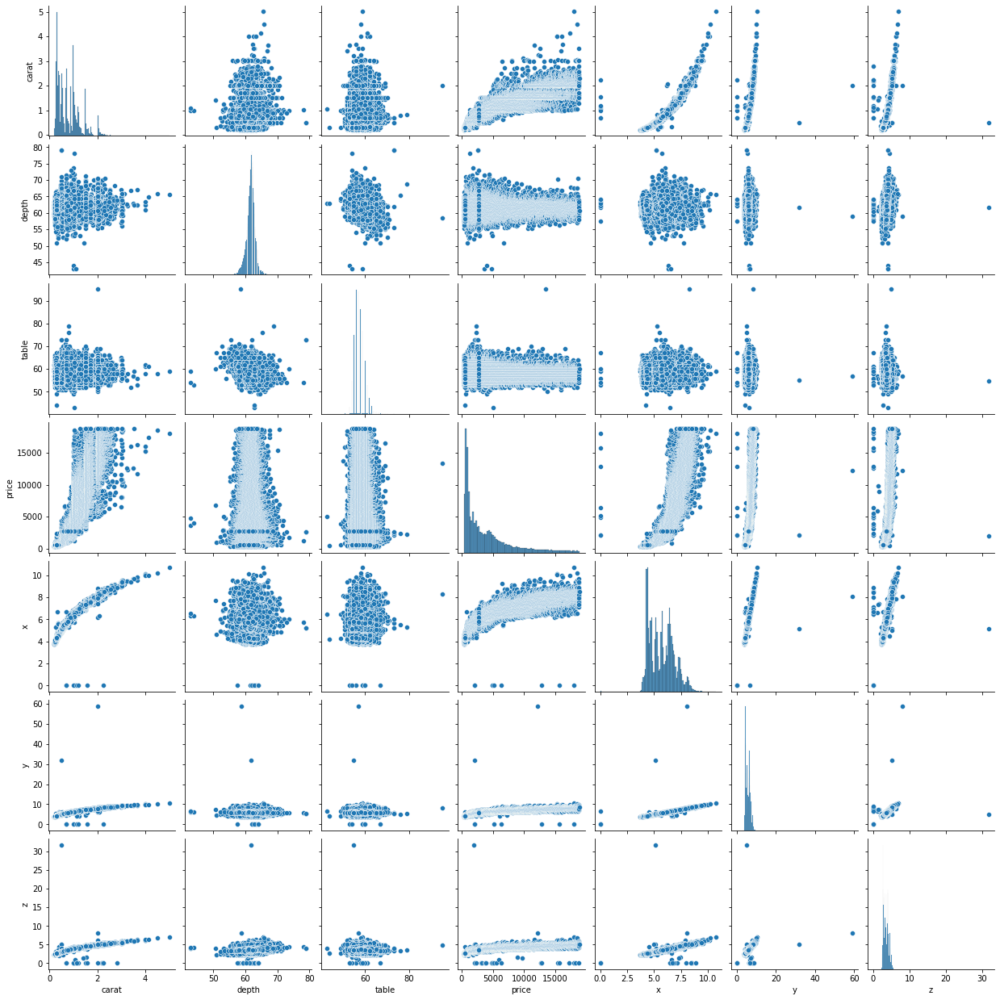

In [15]:
ax = sns.pairplot(df)

#### Observation: Here we are cocerned with only the graphs that show each attribute plotted against the target variable 'price'. The target variable seems to have a skewed distribution. Rest of the attributes seem to have some kind of correlation with 'price'.

In [6]:
num_features = df.select_dtypes(include=['int64', 'float']) #numerical features
cat_features = df.select_dtypes(include=['object']) # categorical features

#### 1.3 Distributions of numerical features

In [7]:
colors = ['blue', 'red', 'green', 'black', 'brown', 'blue', 'red', 'green', 'black', 'brown']
for num, col in enumerate(num_features.columns):
    fig = px.histogram(x = num_features[col], nbins=50, title='{} distribution'.format(col), marginal='violin', color_discrete_sequence=[colors[num]],
              labels={'x':'{}'.format(col), 'y':'Count'}, width=800, height=400)
  
    fig.show()

#### Observation: All the numerical attributes seem to have a skewed distribution except for 'table' and 'x'.

#### 1.4 Distributions of categorical features

In [8]:
fig1 = px.histogram(x = cat_features['cut'], nbins=10, marginal='violin', color_discrete_sequence=['red'], width=800, height=300, labels={'x': 'Cut', 'y': 'Count'})
#plotting distribution of 'cut'
fig2 = px.histogram(x = cat_features['color'], nbins=10, marginal='violin', color_discrete_sequence=['blue'], width=800, height=300, labels={'x': 'color', 'y': 'Count'})
#plotting distribution of 'color'
fig3 = px.histogram(x = cat_features['clarity'], nbins=10, marginal='violin', color_discrete_sequence=['green'], width=800, height=300, labels={'x': 'clarity', 'y': 'Count'})
#plotting distribution of 'clarity'

fig1.show()
fig2.show()
fig3.show()

In [32]:
display(cat_features.cut.value_counts())
print(' ')
display(cat_features.color.value_counts())
print(' ')
display(cat_features.clarity.value_counts())


Ideal        21551
Premium      13791
Very Good    12082
Good          4906
Fair          1610
Name: cut, dtype: int64

G    11292
E     9797
F     9542
H     8304
D     6775
I     5422
J     2808
Name: color, dtype: int64

SI1     13065
VS2     12258
SI2      9194
VS1      8171
VVS2     5066
VVS1     3655
IF       1790
I1        741
Name: clarity, dtype: int64

#### Observation: There seems to be a good split between the different values of categorical attributes.

#### 1.5 Grading and encoding the categorical attributes
#### Diamonds are graded into the following:

•Cut grading

Ideal cut > Premium cut > Very Good (or Fine) cut > Good cut > Fair cut > Poor cut

•Color grading

D > E > F > G > H > I > J

•Clarity grading

IF > VVS1 > VVS2 > VS1 > VS2 > SI1 > SI2 > I1

We manually encoded the categorical attributes because we need the best values to have the highest score for our regression problem.

In [33]:
# Imputing numbers for ordinal categorical features 
nums_for_imputing = {"cut":     {'Ideal': 5, 'Premium': 4, 'Very Good': 3, 'Good': 2, 'Fair':1},
                "color": {"D": 7, "E": 6, "F": 5, "G": 4, "H": 3, "I": 2, "J":1 },
                "clarity": {"IF": 8, "VVS1": 7, "VVS2": 6, "VS1": 5, "VS2": 4,"SI1": 3, "SI2": 2, "I1":1 }}

In [34]:
encoded = cat_features.replace(nums_for_imputing)

In [35]:
df = pd.concat([num_features, encoded], axis=1)
df

,carat,depth,table,price,x,y,z,cut,color,clarity
0,0.23,61.5,55.0,326,3.95,3.98,2.43,5,6,2
1,0.21,59.8,61.0,326,3.89,3.84,2.31,4,6,3
2,0.23,56.9,65.0,327,4.05,4.07,2.31,2,6,5
3,0.29,62.4,58.0,334,4.20,4.23,2.63,4,2,4
4,0.31,63.3,58.0,335,4.34,4.35,2.75,2,1,2
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,60.8,57.0,2757,5.75,5.76,3.50,5,7,3
53936,0.72,63.1,55.0,2757,5.69,5.75,3.61,2,7,3
53937,0.70,62.8,60.0,2757,5.66,5.68,3.56,3,7,3
53938,0.86,61.0,58.0,2757,6.15,6.12,3.74,4,3,2


#### 1.6 Unsupervised feature selection



In [36]:
# Unsupervised feature selection
# Applying correlation analysis without the target value
X, y = df.iloc[:,[0,1,2,4,5,6,7,8,9]], df.iloc[:,[3]]
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)


In [37]:
from sklearn.preprocessing import scale
X_train_scaled = scale(X_train) #scaling the dataset
cov = np.cov(X_train_scaled, rowvar=False)

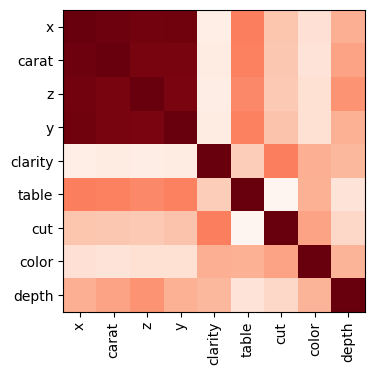

In [38]:
order = np.argsort(np.linalg.norm(cov,axis=1))[::-1]
#plotting correlation matrix
plt.figure(figsize=(4, 4), dpi=100)  
plt.imshow(cov[order, :][:, order],cmap='Reds')
plt.xticks(range(X.shape[1]), X.columns[order], rotation=90)
plt.yticks(range(X.shape[1]), X.columns[order])
plt.show()

#### Observation: Carat, x, y, and z attributes are highly correlated with each other. We remove the x, y, and z attributes and keep the carat attribute.

In [39]:
# Dropping x,y, and z features
df = df.drop(['x','y','z'],axis=1)

In [40]:
# Applying correlation analysis with the target value
pcorr = df.corr(method='pearson')
pcorr.loc["price"]

carat      0.921591
depth     -0.010647
table      0.127134
price      1.000000
cut       -0.053491
color     -0.172511
clarity   -0.146800
Name: price, dtype: float64

#### 1.7 Correlation analysis with target value

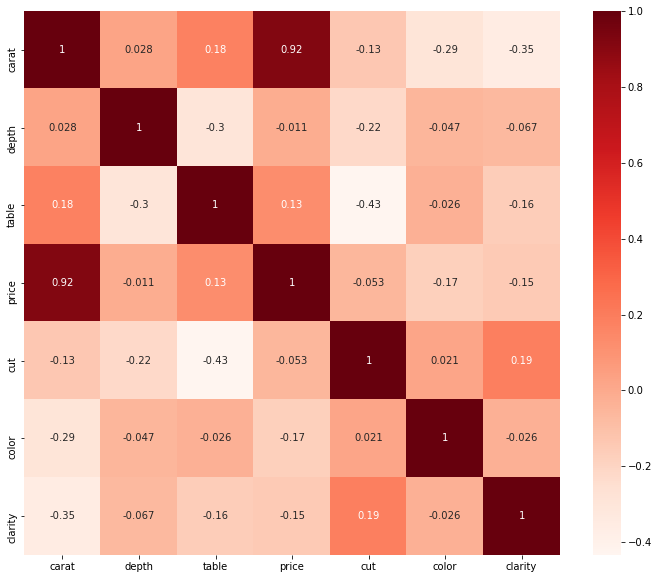

In [41]:
plt.figure(figsize=(12,10))
sns.heatmap(pcorr, annot=True, cmap=plt.cm.Reds)
plt.show()

#### The carat attribute seems to be highly correlated with the target value. It shows that the price of diamonds increases as they grow in size. Let's leave it there.

#### 1.8 Plotting the label encoded dataset

In [42]:
# encoded = cat_features.apply(LabelEncoder().fit_transform)
# df = pd.concat([num_features, encoded], axis=1)

df_original = df.copy()
#Using 2.5 as a threshold. We can exclude 0.25% of data.
z = np.abs(stats.zscore(df))
df = df[(z < 2.5).all(axis=1)]

In [43]:
df_original.shape, df.shape

((53940, 7), (48670, 7))

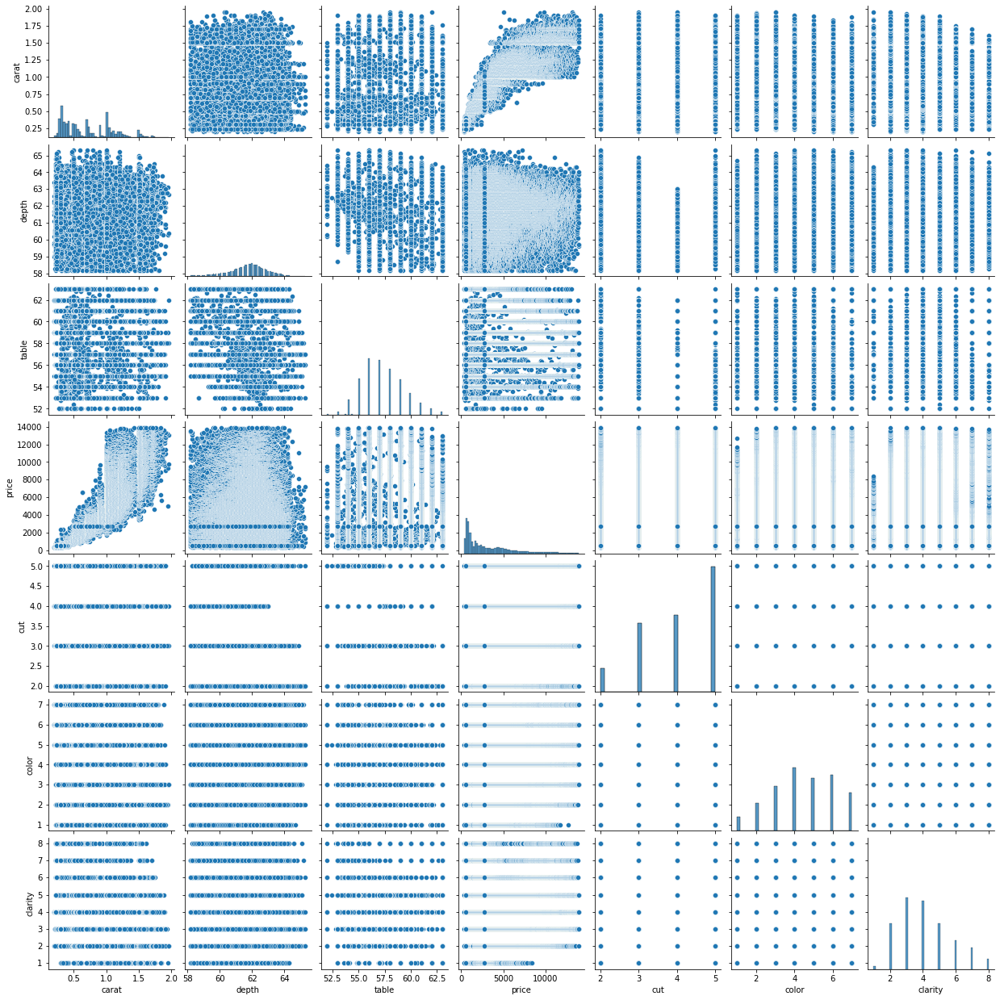

In [ ]:
ax = sns.pairplot(df)

#### Observation: The price column seems to show a good correlation with the numercial and label encoded categorical features.

#### 1.9 Regression: Using the entire data set

In [ ]:
X = df_original.drop(["price"],axis =1)
y = df_original["price"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)#train and test split

In [ ]:
""" creating pipelines for all the algorithms
1) Linear Regression
2) DecisionTreeRegressor
3) RandomForestRegressor
4) KNeighborsRegressor
5) XGBRegressor
"""

pipeline_lr=Pipeline([("scalar1",StandardScaler()),
                     ("lr_classifier",LinearRegression())])

pipeline_dt=Pipeline([("scalar2",StandardScaler()),
                     ("dt_classifier",DecisionTreeRegressor())])

pipeline_rf=Pipeline([("scalar3",StandardScaler()),
                     ("rf_classifier",RandomForestRegressor())])


pipeline_kn=Pipeline([("scalar4",StandardScaler()),
                     ("rf_classifier",KNeighborsRegressor())])


pipeline_xgb=Pipeline([("scalar5",StandardScaler()),
                     ("rf_classifier",XGBRegressor())])

pipelines = [pipeline_lr, pipeline_dt, pipeline_rf, pipeline_kn, pipeline_xgb]

In [ ]:
for pipe in pipelines:
    print(pipe)
    pipe.fit(X_train, y_train)

Pipeline(memory=None,
         steps=[('scalar1',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('lr_classifier',
                 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
                                  normalize=False))],
         verbose=False)
Pipeline(memory=None,
         steps=[('scalar2',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('dt_classifier',
                 DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse',
                                       max_depth=None, max_features=None,
                                       max_leaf_nodes=None,
                                       min_impurity_decrease=0.0,
                                       min_impurity_split=None,
                                       min_samples_leaf=1, min_samples_split=2,
                                       min_weight_fraction_leaf=0.0,
                                      

In [ ]:
#printing thr r2 scores
cv_r2 = []
for i, model in enumerate(pipelines):
    cv = cross_val_score(model, X_train,y_train,scoring="r2", cv=10)
    cv_r2.append(cv)

print('r2-LinearRegression', cv_r2[0].mean())
print('r2-DecisionTree', cv_r2[1].mean())
print('r2-RandomForest', cv_r2[2].mean())
print('r2-KNeighbors', cv_r2[3].mean())
print('r2-XGBRegressor', cv_r2[4].mean())

[23:59:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[23:59:20] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[23:59:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[23:59:24] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[23:59:25] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[23:59:27] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[23:59:29] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[23:59:30] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of re

#### Observation: Random forest regressor had the best performance and that is the alogrithm on which hyperparameter tuning will be performed on.

#### 1.10 Hyperparameter tuning 

In [ ]:
#hyperparameter tuning for random forest regressor
param_grid = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100, 110],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4, 5],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [100, 200, 300]
}

rf = RandomForestRegressor()

grid_search = make_pipeline(StandardScaler(), GridSearchCV(estimator = rf, param_grid = param_grid, cv = 3))

grid_search.fit(X_train, y_train)

Pipeline(memory=None,
         steps=[('standardscaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('gridsearchcv',
                 GridSearchCV(cv=3, error_score=nan,
                              estimator=RandomForestRegressor(bootstrap=True,
                                                              ccp_alpha=0.0,
                                                              criterion='mse',
                                                              max_depth=None,
                                                              max_features='auto',
                                                              max_leaf_nodes=None,
                                                              max_samples=None,
                                                              min_impurity_decrease=0.0,
                                                              min_impurity_split=None...
                                             

In [ ]:
y_pred = grid_search.predict(X_test)

In [ ]:
r2_score(y_test, y_pred)

0.9818838298198658

#### 1.11 Regression: Using the .25% of outliers removed dataset

In [ ]:
X = df.drop(["price"],axis =1)
y = df["price"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

In [ ]:
""" creating pipelines for all the algorithms
1) Linear Regression
2) DecisionTreeRegressor
3) RandomForestRegressor
4) KNeighborsRegressor
5) XGBRegressor
"""

pipeline_lr=Pipeline([("scalar1",StandardScaler()),
                     ("lr_classifier",LinearRegression())])

pipeline_dt=Pipeline([("scalar2",StandardScaler()),
                     ("dt_classifier",DecisionTreeRegressor())])

pipeline_rf=Pipeline([("scalar3",StandardScaler()),
                     ("rf_classifier",RandomForestRegressor())])


pipeline_kn=Pipeline([("scalar4",StandardScaler()),
                     ("rf_classifier",KNeighborsRegressor())])


pipeline_xgb=Pipeline([("scalar5",StandardScaler()),
                     ("rf_classifier",XGBRegressor())])

pipelines = [pipeline_lr, pipeline_dt, pipeline_rf, pipeline_kn, pipeline_xgb]

In [ ]:
for pipe in pipelines:
    print(pipe)
    pipe.fit(X_train, y_train)

Pipeline(memory=None,
         steps=[('scalar1',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('lr_classifier',
                 LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None,
                                  normalize=False))],
         verbose=False)
Pipeline(memory=None,
         steps=[('scalar2',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('dt_classifier',
                 DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse',
                                       max_depth=None, max_features=None,
                                       max_leaf_nodes=None,
                                       min_impurity_decrease=0.0,
                                       min_impurity_split=None,
                                       min_samples_leaf=1, min_samples_split=2,
                                       min_weight_fraction_leaf=0.0,
                                      

In [ ]:
cv_r2 = []
for i, model in enumerate(pipelines):
    cv = cross_val_score(model, X_train,y_train,scoring="r2", cv=10)
    cv_r2.append(cv)

print('r2-LinearRegression', cv_r2[0].mean())
print('r2-DecisionTree', cv_r2[1].mean())
print('r2-RandomForest', cv_r2[2].mean())
print('r2-KNeighbors', cv_r2[3].mean())
print('r2-XGBRegressor', cv_r2[4].mean())

[04:25:10] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[04:25:12] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[04:25:13] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[04:25:14] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[04:25:15] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[04:25:17] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[04:25:18] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[04:25:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of re

#### Observation: The random forest regressor again gave us the best performance and that is the algorithm on which hyperparameter tuning will be performed on.

#### 1.12 Hyperparameter tuning

In [ ]:
param_grid = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100, 110],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4, 5],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [100, 200, 300]
}

rf = RandomForestRegressor()

grid_search = make_pipeline(StandardScaler(), GridSearchCV(estimator = rf, param_grid = param_grid, cv = 3))

grid_search.fit(X_train, y_train)

Pipeline(memory=None,
         steps=[('standardscaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('gridsearchcv',
                 GridSearchCV(cv=3, error_score=nan,
                              estimator=RandomForestRegressor(bootstrap=True,
                                                              ccp_alpha=0.0,
                                                              criterion='mse',
                                                              max_depth=None,
                                                              max_features='auto',
                                                              max_leaf_nodes=None,
                                                              max_samples=None,
                                                              min_impurity_decrease=0.0,
                                                              min_impurity_split=None...
                                             

In [ ]:
y_pred = grid_search.predict(X_test)

In [ ]:
r2_score(y_test, y_pred)

0.9829972106613734

## ----------------------------------------------------------------------------------------------------------------------------------


## Stage 2: DBSCAN and Regression

In [44]:
#resetting index
df_new_index = df.reset_index(drop=True)

X = df_new_index.drop(["price"],axis =1)
y = df_new_index["price"]
X.columns

Index(['carat', 'depth', 'table', 'cut', 'color', 'clarity'], dtype='object')

In [45]:
# Scaling X
from sklearn.preprocessing import MinMaxScaler
min_max_scaler = MinMaxScaler()
X[['carat', 'depth', 'table', 'cut', 'color', 'clarity']] = min_max_scaler.fit_transform(X[['carat', 'depth', 'table', 'cut', 'color', 'clarity']])


#### 2.1 Clustering using DBSCAN

5 clusters are created, but one of them is a collection of outliers hence the analysis will be done on the remaining 4 clusters.

In [46]:
# DBSCAN

from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=0.3333333, min_samples=5)
dbscan.fit(X)

DBSCAN(eps=0.3333333)

In [47]:
# We have 5 clusters but the -1 cluster is a collection of outliers.
np.unique(dbscan.labels_)

array([-1,  0,  1,  2,  3], dtype=int64)

In [48]:
predict = pd.DataFrame(dbscan.fit_predict(X))

In [49]:
predict.columns = ['label']

In [50]:
# concatenating labels to X and y as a new column
labeled_df = pd.concat([X,predict,y],axis=1)

#### 2.2 Clustered dataset

In [51]:
labeled_df

,carat,depth,table,cut,color,clarity,label,price
0,0.017045,0.464789,0.272727,1.000000,0.833333,0.142857,0,326
1,0.005682,0.225352,0.818182,0.666667,0.833333,0.285714,1,326
2,0.051136,0.591549,0.545455,0.666667,0.166667,0.428571,1,334
3,0.062500,0.718310,0.545455,0.000000,0.000000,0.142857,2,335
4,0.022727,0.647887,0.454545,0.333333,0.000000,0.714286,3,336
...,...,...,...,...,...,...,...,...
48665,0.295455,0.366197,0.454545,1.000000,1.000000,0.285714,0,2757
48666,0.295455,0.690141,0.272727,0.000000,1.000000,0.285714,2,2757
48667,0.284091,0.647887,0.727273,0.333333,1.000000,0.285714,3,2757
48668,0.375000,0.394366,0.545455,0.666667,0.333333,0.142857,1,2757


In [ ]:
# Checking # of instances of each cluster

for i in np.unique(dbscan.labels_):
    if i == -1:
        print("Outliers")
        print(labeled_df[labeled_df["label"] == i])
    else:
        print("The shape of Cluster", i)
        print(labeled_df[labeled_df["label"] == i].shape)

Outliers
          carat     depth     table  cut  color   clarity  label  price
11953  0.517045  0.014085  0.909091  0.0    0.0  1.000000     -1   5361
21806  0.914773  0.098592  0.272727  0.0    0.5  0.142857     -1  11336
The shape of Cluster 0
(20711, 8)
The shape of Cluster 1
(12633, 8)
The shape of Cluster 2
(3941, 8)
The shape of Cluster 3
(11383, 8)


#### 2.3 PCA is performed to reduce the dimensionality to 2 and the clusters are visualized below

In [ ]:
from sklearn.decomposition import PCA


labeled_X = labeled_df[['carat', 'depth', 'table', 'cut', 'color', 'clarity']] # It's scaled.
labeled_y = labeled_df['label']

#performing PCA to reduce the number of features to 2
pca = PCA(2)
 
#Transform the data
X_pca_scaled = pca.fit_transform(labeled_X)

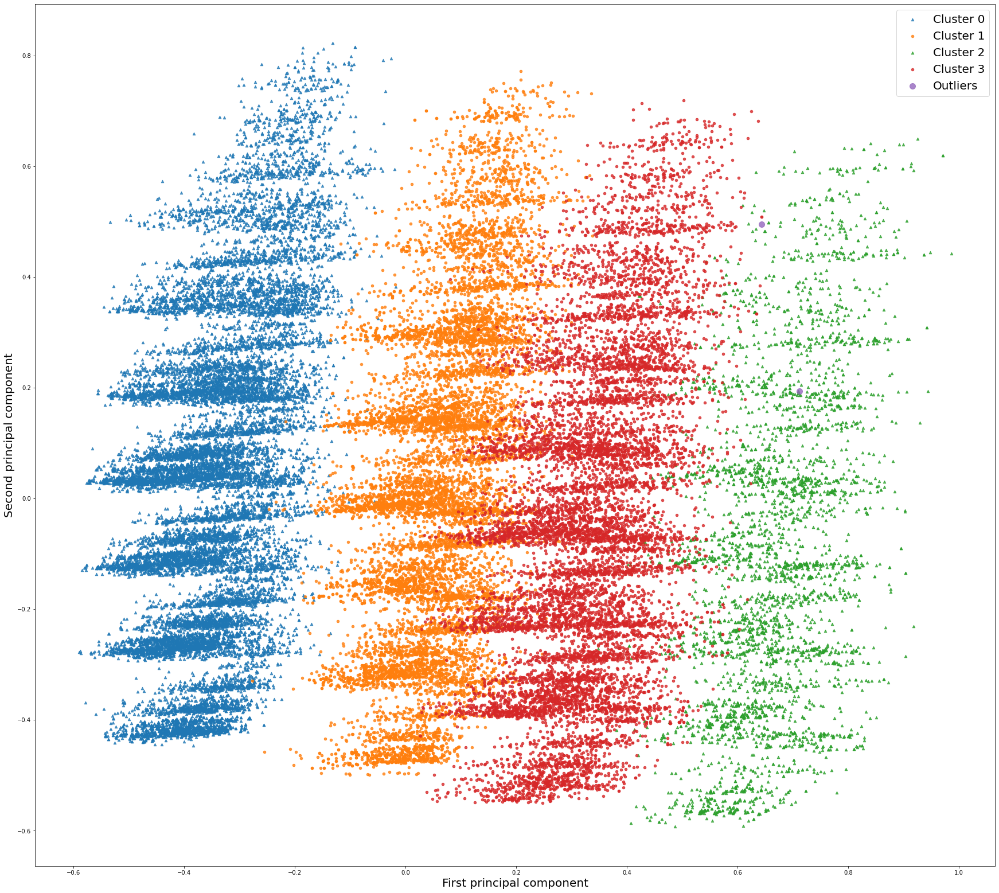

In [ ]:
# the visualization of PCA using top two principal components
plt.figure(figsize = (30,30))
plt.scatter(X_pca_scaled[labeled_y==0, 0], X_pca_scaled[labeled_y==0, 1], 
            marker = '^', alpha=.8, label = 'Cluster 0', s=20)
plt.scatter(X_pca_scaled[labeled_y==1, 0], X_pca_scaled[labeled_y==1, 1], 
            marker = 'o', alpha=.8, label = 'Cluster 1', s=20)
plt.scatter(X_pca_scaled[labeled_y==2, 0], X_pca_scaled[labeled_y==2, 1], 
            marker = '^', alpha=.8, label = 'Cluster 2', s=20)
plt.scatter(X_pca_scaled[labeled_y==3, 0], X_pca_scaled[labeled_y==3, 1], 
            marker = 'o', alpha=.8, label = 'Cluster 3', s=20)
plt.scatter(X_pca_scaled[labeled_y==-1, 0], X_pca_scaled[labeled_y==-1, 1], 
            marker = 'o', alpha=.8, label = 'Outliers', s=100)
plt.gca().set_aspect("equal")
plt.xlabel("First principal component", fontsize = 20)
plt.ylabel("Second principal component", fontsize = 20)
plt.legend(loc='best', fontsize = 20)
plt.show()

#### Observation: We can observe separations among clusters. There are overlaps between cluster 1 and cluster 3. Let's find the proper predictive model for each cluster.

#### 2.4 Regression for 4 clusters.

In [ ]:
""" creating pipelines for all the algorithms
1) Linear Regression
2) DecisionTreeRegressor
3) RandomForestRegressor
4) KNeighborsRegressor
5) XGBRegressor
"""

pipeline_lr=Pipeline([("scalar1",StandardScaler()),
                     ("lr_classifier",LinearRegression())])

pipeline_dt=Pipeline([("scalar2",StandardScaler()),
                     ("dt_classifier",DecisionTreeRegressor())])

pipeline_rf=Pipeline([("scalar3",StandardScaler()),
                     ("rf_classifier",RandomForestRegressor())])


pipeline_kn=Pipeline([("scalar4",StandardScaler()),
                     ("rf_classifier",KNeighborsRegressor())])


pipeline_xgb=Pipeline([("scalar5",StandardScaler()),
                     ("rf_classifier",XGBRegressor())])

pipelines = [pipeline_lr, pipeline_dt, pipeline_rf, pipeline_kn, pipeline_xgb]

In [ ]:
# Applying Linear Regression, Decision Tree, Random Forest, kNN, and XGB Regression on each cluster
# Getting r2 scores to see performance of each model
for i in range(4):
    print("==================================================")
    print("==================================================")
    print("The cluster ", i)
    cluster = labeled_df[labeled_df["label"] == i]
    X = cluster.drop(["price","label"],axis =1)
    y = cluster["price"]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
    for pipe in pipelines:
        pipe.fit(X_train, y_train)
        cv_r2 = []
          for i, model in enumerate(pipelines):
        cv = cross_val_score(model, X_train,y_train,scoring="r2", cv=10)
        cv_r2.append(cv)

    print('r2-LinearRegression', cv_r2[0].mean())
    print('r2-DecisionTree', cv_r2[1].mean())
    print('r2-RandomForest', cv_r2[2].mean())
    print('r2-KNeighbors', cv_r2[3].mean())
    print('r2-XGBRegressor', cv_r2[4].mean())

The cluster  0
[01:18:00] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:18:33] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:18:33] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:18:34] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:18:34] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:18:35] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:18:36] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[01:18:36] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated

#### Observation: For all clusters, the Random Forest algorithm showed the best performance.

#### 2.6 Hyperparameter tuning for Random Forest Regressor

In [ ]:
# Hyperparameter tuning for Random Forest Algorithm
param_grid = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100, 110],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4, 5],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [100, 200, 300]
}

rf = RandomForestRegressor()

grid_search = make_pipeline(StandardScaler(), GridSearchCV(estimator = rf, param_grid = param_grid, cv = 3))

In [ ]:
for i in range(4):
    print("==================================================")
    print("==================================================")
    print("The cluster ", i)
    cluster = labeled_df[labeled_df["label"] == i]
    X = cluster.drop(["price","label"],axis =1)
    y = cluster["price"]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

    grid_search.fit(X_train, y_train)
    y_pred = grid_search.predict(X_test)
    print(r2_score(y_test, y_pred))

The cluster  0
0.9826922665904866
The cluster  1
0.9786934635935912
The cluster  2
0.9668097365997053
The cluster  3
0.9838775860950318


#### Observation: The r2 score of the Random Forest Algorithm for the whole data set was 0.9829972106613734. Cluster 0 has a similar r2 score. But clusters 1 and 2 have lower r2 scores. Cluster 3 shows the best performance but cluster 3 only contains 21% of the whole data.

#### 2.7 Creating two clusters using DBSCAN as a outlier detector

In [52]:
# DBSCAN

from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=1/3, min_samples=2)
dbscan.fit(X)

DBSCAN(eps=0.3333333333333333, min_samples=2)

In [53]:
# We have 3 clusters but the -1 cluster is a collection of outliers.
np.unique(dbscan.labels_)

array([-1,  0,  1], dtype=int64)

In [54]:
predict = pd.DataFrame(dbscan.fit_predict(X))
predict.columns = ['label']

# concatenating labels to X and y as a new column
labeled_df = pd.concat([X,predict,y],axis=1)

#### 2.8 Two-cluster dataset

In [55]:
labeled_df

,carat,depth,table,cut,color,clarity,label,price
0,0.017045,0.464789,0.272727,1.000000,0.833333,0.142857,0,326
1,0.005682,0.225352,0.818182,0.666667,0.833333,0.285714,0,326
2,0.051136,0.591549,0.545455,0.666667,0.166667,0.428571,0,334
3,0.062500,0.718310,0.545455,0.000000,0.000000,0.142857,1,335
4,0.022727,0.647887,0.454545,0.333333,0.000000,0.714286,0,336
...,...,...,...,...,...,...,...,...
48665,0.295455,0.366197,0.454545,1.000000,1.000000,0.285714,0,2757
48666,0.295455,0.690141,0.272727,0.000000,1.000000,0.285714,1,2757
48667,0.284091,0.647887,0.727273,0.333333,1.000000,0.285714,0,2757
48668,0.375000,0.394366,0.545455,0.666667,0.333333,0.142857,0,2757


In [ ]:
# Checking # of instances of each cluster

for i in np.unique(dbscan.labels_):
    if i == -1:
        print("Outliers")
        print(labeled_df[labeled_df["label"] == i])
    else:
        print("The shape of Cluster", i)
        print(labeled_df[labeled_df["label"] == i].shape)

Outliers
          carat     depth     table  cut  color  clarity  label  price
11953  0.517045  0.014085  0.909091  0.0    0.0      1.0     -1   5361
The shape of Cluster 0
(44727, 8)
The shape of Cluster 1
(3942, 8)


#### 2.9 Performing PCA and visualizing clusters

In [ ]:
from sklearn.decomposition import PCA


labeled_X = labeled_df[['carat', 'depth', 'table', 'cut', 'color', 'clarity']] # It's scaled.
labeled_y = labeled_df['label']

#performing PCA to reduce the number of features to 2
pca = PCA(2)
 
#Transform the data
X_pca_scaled = pca.fit_transform(labeled_X)

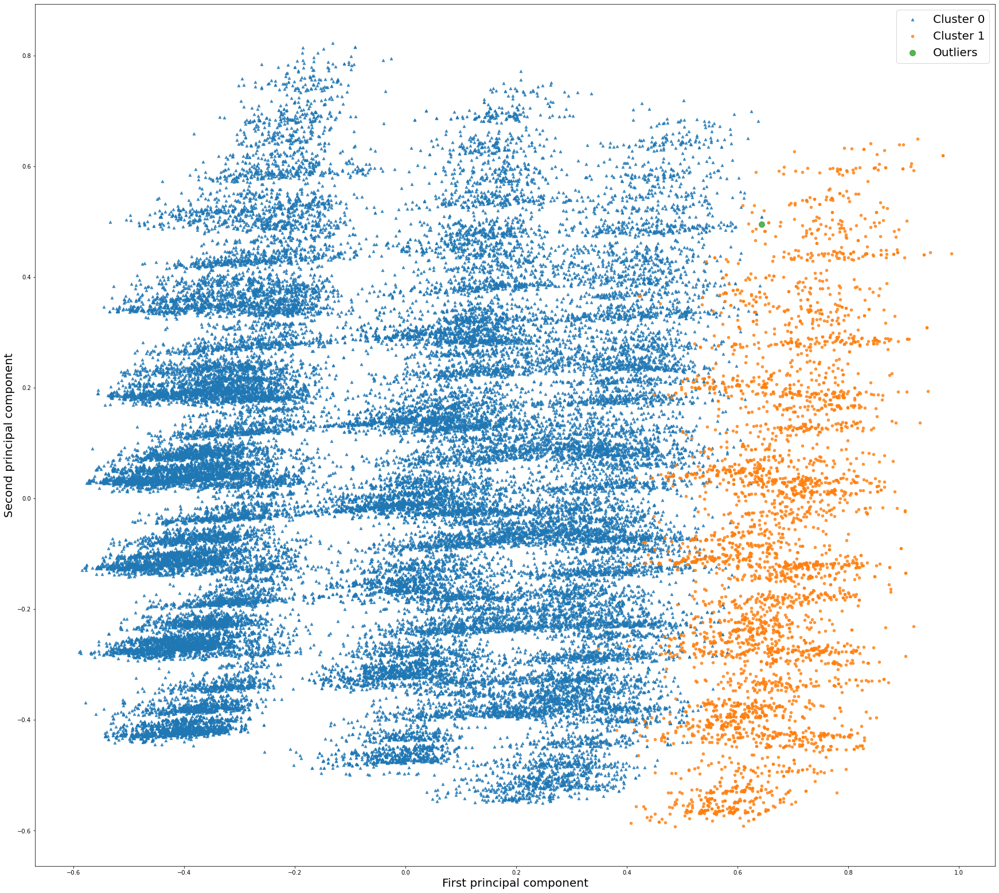

In [ ]:
# the visualization of PCA using top two principal components
plt.figure(figsize = (30,30))
plt.scatter(X_pca_scaled[labeled_y==0, 0], X_pca_scaled[labeled_y==0, 1], 
            marker = '^', alpha=.8, label = 'Cluster 0', s=20)
plt.scatter(X_pca_scaled[labeled_y==1, 0], X_pca_scaled[labeled_y==1, 1], 
            marker = 'o', alpha=.8, label = 'Cluster 1', s=20)
plt.scatter(X_pca_scaled[labeled_y==-1, 0], X_pca_scaled[labeled_y==-1, 1], 
            marker = 'o', alpha=.8, label = 'Outliers', s=100)
plt.gca().set_aspect("equal")
plt.xlabel("First principal component", fontsize = 20)
plt.ylabel("Second principal component", fontsize = 20)
plt.legend(loc='best', fontsize = 20)
plt.show()

#### Observation: There are some overlaps between cluster 0 and cluster 1. Cluster 1 seems to be very similar the cluster 2 of previous PCA plotting. Let's find the proper predictive model for each cluster. Then let's determine to treat this cluster 1 as outliers or not.

#### 2.10 Regression for each cluster

In [ ]:
""" creating pipelines for all the algorithms
1) Linear Regression
2) DecisionTreeRegressor
3) RandomForestRegressor
4) KNeighborsRegressor
5) XGBRegressor
"""
pipeline_lr=Pipeline([("scalar1",StandardScaler()),
                     ("lr_classifier",LinearRegression())])

pipeline_dt=Pipeline([("scalar2",StandardScaler()),
                     ("dt_classifier",DecisionTreeRegressor())])

pipeline_rf=Pipeline([("scalar3",StandardScaler()),
                     ("rf_classifier",RandomForestRegressor())])


pipeline_kn=Pipeline([("scalar4",StandardScaler()),
                     ("rf_classifier",KNeighborsRegressor())])


pipeline_xgb=Pipeline([("scalar5",StandardScaler()),
                     ("rf_classifier",XGBRegressor())])

pipelines = [pipeline_lr, pipeline_dt, pipeline_rf, pipeline_kn, pipeline_xgb]

In [ ]:
# Applying Linear Regression, Decision Tree, Random Forest, kNN, and XGB Regression on each cluster
# Getting r2 scores to see performance of each model
for i in range(2):
    print("==================================================")
    print("==================================================")
    print("The cluster ", i)
    cluster = labeled_df[labeled_df["label"] == i]
    X = cluster.drop(["price","label"],axis =1)
    y = cluster["price"]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
    for pipe in pipelines:
        pipe.fit(X_train, y_train)
    cv_r2 = []
    for i, model in enumerate(pipelines):
        cv = cross_val_score(model, X_train,y_train,scoring="r2", cv=10)
        cv_r2.append(cv)

    print('r2-LinearRegression', cv_r2[0].mean())
    print('r2-DecisionTree', cv_r2[1].mean())
    print('r2-RandomForest', cv_r2[2].mean())
    print('r2-KNeighbors', cv_r2[3].mean())
    print('r2-XGBRegressor', cv_r2[4].mean())

The cluster  0
[22:45:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:46:38] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:46:39] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:46:41] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:46:42] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:46:43] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:46:44] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[22:46:45] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated

#### 2.11 Hyperparameter tuning

In [ ]:
# Hyperparameter tuning for Random Forest Algorithm
param_grid = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100, 110],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4, 5],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [100, 200, 300]
}

rf = RandomForestRegressor()

grid_search = make_pipeline(StandardScaler(), GridSearchCV(estimator = rf, param_grid = param_grid, cv = 3))

In [ ]:
for i in range(2):
    print("==================================================")
    print("==================================================")
    print("The cluster ", i)
    cluster = labeled_df[labeled_df["label"] == i]
    X = cluster.drop(["price","label"],axis =1)
    y = cluster["price"]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

    grid_search.fit(X_train, y_train)
    y_pred = grid_search.predict(X_test)
    print(r2_score(y_test, y_pred))

The cluster  0
0.983870009266275
The cluster  1
0.9703744368458357



#### Observation: The best r2 score, so far, was 0.9838775860950318 of previous Cluster 3 with 11383 instances. The r2 score of cluster 0 is 0.983870009266275, which is very close to the best r2 score. However, this cluster 0 holds 83% of the whole data. Previous cluster 3 only contains 21% of the entire data. In this case, we can see that DBSCAN can be used as outlier detection.


## ----------------------------------------------------------------------------------------------------------------------------------

## Conclusion

### 1) Regression with entire dataset r2 scores :

Linear Regression : 0.9040

Decision Tree Regressor : 0.9661

Random Forest Regressor : 0.9806

K Neighbors Regressor : 0.9583

XGB Regressor : 0.9759



##### Random forest Without hyperparameter tuning: 0.9806

##### Random forest With hyperparameter tuning: 0.9818
### ------------------------------------------------------------------------------------------------

### 2) Regression with 0.25% dataset r2 scores :


Linear Regression : 0.9071

Decision Tree Regressor : 0.9702

Random Forest Regressor : 0.9825

K Neighbors Regressor : 0.9630

XGB Regressor : 0.9790


##### Random forest Without hyperparameter tuning: 0.9825

##### Random forest With hyperparameter tuning: 0.9829
### ------------------------------------------------------------------------------------------------


### 3) DBSCAN and Regression for 4 clusters

##### Cluster 0:

Linear Regression : 0.9094

Decision Tree Regressor : 0.9707

Random Forest Regressor : 0.9825

K Neighbors Regressor : 0.9642

XGB Regressor : 0.9804

##### Cluster 1:

Linear Regression : 0.9075

Decision Tree Regressor : 0.9631

Random Forest Regressor : 0.9779

K Neighbors Regressor : 0.9494

XGB Regressor : 0.9768

##### Cluster 2:

Linear Regression : 0.9045

Decision Tree Regressor : 0.9578

Random Forest Regressor : 0.9756

K Neighbors Regressor : 0.9364

XGB Regressor : 0.9743


##### Cluster 3:

Linear Regression : 0.9155

Decision Tree Regressor : 0.9708

Random Forest Regressor : 0.9830

K Neighbors Regressor : 0.9607

XGB Regressor : 0.9825



##### With hyperparameter tuning for random forest:  

Cluster 0: 0.9826

Cluster 1: 0.9786

Cluster 2: 0.9668 (3941 instances, the lowest r2 score)

Cluster 3: 0.9838 (11383 instances)

### ------------------------------------------------------------------------------------------------

### 4) DBSCAN and Regression for 2 clusters

##### Cluster 0:

Linear Regression : 0.9088

Decision Tree Regressor : 0.9699

Random Forest Regressor : 0.9824

K Neighbors Regressor : 0.9626

XGB Regressor : 0.9792

##### Cluster 1:

Linear Regression : 0.9044

Decision Tree Regressor : 0.9591

Random Forest Regressor : 0.9743

K Neighbors Regressor : 0.9356

XGB Regressor : 0.9740

##### Hyperparameter tuning for Random Forest Regressor
Cluster 0: 0.9838 (44727 instances)

Cluster 1: 0.9703





#### Random forest algorithms gave us the best results in both stages of the project, although the other algorithms weren’t behind my a lot. We believe the tree based algorithms performed the best because there were a good range of categorical attributes that had a good correlativity with the target attribute 'price'.



## ----------------------------------------------------------------------------------------------------------------------------------

## Workload distribution:

##### Coding: Himanshu Jat, Richard Hong, Manoj Venkatachalaiah

##### Report making: Himanshu Jat, Richard Hong, Manoj Venkatachalaiah

## ----------------------------------------------------------------------------------------------------------------------------------